<a href="https://colab.research.google.com/github/alonsomoros/PracticaMetodosGenerativos/blob/main/Modelo3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install tensorflow==2.10.0

#Imports

In [ ]:
import os
import librosa
import numpy as np
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import tarfile

#Para Cargar el Dataset desde Google Colab

  (Antes de ejecutar las estas celdas de código)

1. Descarga el dataset de LJSpeech de esta URL: https://keithito.com/LJ-Speech-Dataset/
2. El archivo se descargará con la extensión ".tar.bz2". Bueno pues descomprime el archivo para que solo tengas la extensión ".tar"
3. Sube el archivo .tar a tu unidad de Google Drive (Necesitarás como 3Gb libres)

Monta en el sistema de archivos de Colab tu unidad de Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Descomprime el archivo .tar de tu unidad en Google Drive a una carpeta nueva llamada dataset

In [ ]:
# Nombre del archivo .tar y la carpeta de destino
nombre_archivo_tar = '/content/drive/MyDrive/LJSpeech-1.1.tar'
carpeta_destino = '/content/dataset'

# Abrir el archivo .tar y extraer su contenido
with tarfile.open(nombre_archivo_tar, 'r') as archivo_tar:
    archivo_tar.extractall(path=carpeta_destino)

print('Archivo descomprimido correctamente.')


Archivo descomprimido correctamente.


Código necesario para que el modelo entienda el DataSet

In [ ]:
# Configuración
data_dir = '/content/dataset/LJSpeech-1.1'
wav_dir = os.path.join(data_dir, 'wavs')
metadata_file = os.path.join(data_dir, 'metadata.csv')
sample_rate = 22050
max_length = 250  # Ajusta según tus necesidades

# Función para cargar y preprocesar audio
def load_audio(file_path, sample_rate):
    audio, _ = librosa.load(file_path, sr=sample_rate)
    return audio

# Función para convertir audio a espectrograma
def audio_to_spectrogram(audio, sample_rate):
    # Calculate mel-scaled spectrogram
    mel_spectrogram = librosa.feature.melspectrogram(y=audio, sr=sample_rate, n_mels=128)

    # Convert to log-scaled spectrogram
    log_spectrogram = librosa.power_to_db(mel_spectrogram, ref=np.max)

    # Normalizar el espectrograma al rango [0, 1]
    log_spectrogram -= np.min(log_spectrogram)
    log_spectrogram /= np.max(log_spectrogram)

    return log_spectrogram.T

# Cargar transcripciones y audios
transcriptions = []
spectrograms = []
with open(metadata_file, 'r') as f:
    for i, line in enumerate(f):
        if i >= 1000:
            break  # Exit the loop after processing 1000 lines
        parts = line.strip().split('|')
        file_id = parts[0]
        transcription = parts[2]
        transcriptions.append(transcription)

        # Cargar y procesar audio
        wav_path = os.path.join(wav_dir, f'{file_id}.wav')
        audio = load_audio(wav_path, sample_rate)
        spectrogram = audio_to_spectrogram(audio, sample_rate)

        # Padding o truncamiento
        if spectrogram.shape[0] > max_length:
            spectrogram = spectrogram[:max_length, :]
        else:
            pad_width = max_length - spectrogram.shape[0]
            spectrogram = np.pad(spectrogram, ((0, pad_width), (0, 0)), mode='constant')

        spectrograms.append(spectrogram)

# Convertir a tensores de TensorFlow
transcriptions = np.array(transcriptions)
spectrograms = np.array(spectrograms)
spectrograms = np.expand_dims(spectrograms, axis=-1)  # Añadir dimensión de canal


# Tokenización de transcripciones (simple ejemplo)
tokenizer = tf.keras.preprocessing.text.Tokenizer(char_level=True)
tokenizer.fit_on_texts(transcriptions)
sequences = tokenizer.texts_to_sequences(transcriptions)
sequences = tf.keras.preprocessing.sequence.pad_sequences(sequences, maxlen=max_length)

# Dividir en conjuntos de entrenamiento y validación
train_ratio = 0.8
num_train = int(len(sequences) * train_ratio)

x_train = sequences[:num_train]
y_train = spectrograms[:num_train]
x_val = sequences[num_train:]
y_val = spectrograms[num_train:]

# Modelo

In [ ]:
class TextEncoder(tf.keras.Model):
    def __init__(self, vocab_size, embed_dim):
        super(TextEncoder, self).__init__()
        self.embedding = tf.keras.layers.Embedding(vocab_size, embed_dim)

    def call(self, x):
        return self.embedding(x)

class SpectrogramDecoder(tf.keras.layers.Layer):
    def __init__(self):
        super(SpectrogramDecoder, self).__init__()
        self.dense = tf.keras.layers.Dense(128 * 32 * 1, activation="relu")
        self.reshape = tf.keras.layers.Reshape((128, 32, 1))
        self.conv1 = tf.keras.layers.Conv2D(64, (3, 3), activation="relu", padding="same")
        self.conv2 = tf.keras.layers.Conv2D(32, (3, 3), activation="relu", padding="same")

        # Nueva capa de upsampling
        self.upsampling = tf.keras.layers.Conv2DTranspose(32, (3, 3), strides=(2, 2), padding="same", activation="relu")

        self.conv3 = tf.keras.layers.Conv2D(1, (3, 3), activation="sigmoid", padding="same")

    def call(self, inputs):
        x = self.dense(inputs)
        x = self.reshape(x)
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.upsampling(x)  # Upsample para mejorar la resolución
        x = self.conv3(x)
        return x



class TextToSpectrogram(tf.keras.Model):
    def __init__(self, vocab_size, embed_dim, target_dim):
        super(TextToSpectrogram, self).__init__()
        self.encoder = TextEncoder(vocab_size, embed_dim)
        self.decoder = SpectrogramDecoder(target_dim)

    def call(self, x):
        x = self.encoder(x)
        return self.decoder(x)

class TransformerBlock(tf.keras.layers.Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock, self).__init__()
        self.att = tf.keras.layers.MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = tf.keras.Sequential(
            [tf.keras.layers.Dense(ff_dim, activation="relu"), tf.keras.layers.Dense(embed_dim)]
        )
        self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
        self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
        self.dropout1 = tf.keras.layers.Dropout(rate)
        self.dropout2 = tf.keras.layers.Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)



def create_transformer_model(vocab_size, embed_dim, num_heads, ff_dim, target_dim, max_length):
    # Entrada de texto
    input_text = tf.keras.layers.Input(shape=(max_length,), name="text_input")

    # Embedding con Dropout y soporte para máscaras
    embedding_layer = tf.keras.layers.Embedding(
        vocab_size, embed_dim, mask_zero=True
    )(input_text)
    embedding_layer = tf.keras.layers.Dropout(0.2)(embedding_layer)

    # Apilar múltiples bloques Transformer
    x = embedding_layer
    for _ in range(3):  # Tres bloques Transformer
        transformer_block = TransformerBlock(embed_dim, num_heads, ff_dim)
        x = transformer_block(x, training=False)

    # Aplanar salida del Transformer
    flatten_layer = tf.keras.layers.Flatten()(x)

    # Capas densas con Dropout para decodificación
    dense_layer = tf.keras.layers.Dense(128, activation='relu')(flatten_layer)
    dense_layer = tf.keras.layers.Dropout(0.3)(dense_layer)
    output_layer = tf.keras.layers.Dense(target_dim, activation=None)(dense_layer)

    # Redimensionar salida al formato de espectrograma (max_length x espectrograma)
    assert target_dim % max_length == 0, "El target_dim debe ser divisible por max_length."
    output_spectrogram = tf.keras.layers.Reshape((max_length, target_dim // max_length))(output_layer)

    # Modelo completo
    model = tf.keras.Model(inputs=input_text, outputs=output_spectrogram, name="TextToSpectrogramTransformer")
    return model


# Entrenamiento

In [ ]:
# Crear modelo
vocab_size = len(tokenizer.word_index) + 1
embed_dim = 128
num_heads = 4
ff_dim = 128
target_dim = spectrograms.shape[1] * spectrograms.shape[2]

def laplacian_of_gaussian_filter(size, sigma):
    """
    Crea un filtro Laplaciano de Gauss (LoG) en 2D.
    """
    ax = tf.range(-size // 2 + 1, size // 2 + 1, dtype=tf.float32)
    xx, yy = tf.meshgrid(ax, ax)
    xy_square = xx**2 + yy**2
    gaussian = tf.exp(-xy_square / (2.0 * sigma**2))
    laplacian = (xy_square - 2 * sigma**2) / (sigma**4) * gaussian
    laplacian -= tf.reduce_mean(laplacian)  # Aseguramos que la suma es cero
    return laplacian

def hfen_loss(y_true, y_pred):
    """
    Implementa el HFEN como una pérdida personalizada.
    """
    # Definir el filtro LoG
    size = 15
    sigma = 1.5
    log_filter = laplacian_of_gaussian_filter(size, sigma)
    log_filter = tf.reshape(log_filter, (size, size, 1, 1))  # Ajuste a 4D para convoluciones

    # add channel dim before convolving
    y_true = tf.expand_dims(y_true, axis=-1)  # Add channel dimension at the end
    y_pred = tf.expand_dims(y_pred, axis=-1)  # Add channel dimension at the end

    # Aplicar filtro LoG a las imágenes predichas y reales
    y_true_log = tf.nn.conv2d(y_true, log_filter, strides=[1, 1, 1, 1], padding="SAME")
    y_pred_log = tf.nn.conv2d(y_pred, log_filter, strides=[1, 1, 1, 1], padding="SAME")


    # Calcular la diferencia L2 entre las imágenes procesadas
    hfen = tf.reduce_mean(tf.square(y_true_log - y_pred_log))
    return hfen

def combined_loss(y_true, y_pred):
    alpha = 0.5  # Ajustar el peso entre HFEN y MSE
    hfen = hfen_loss(y_true, y_pred)  # Supongo que ya está definida
    mse = tf.keras.losses.MeanSquaredError()(y_true, y_pred)
    return alpha * hfen + (1 - alpha) * mse



model = create_transformer_model(vocab_size, embed_dim, num_heads, ff_dim, target_dim, max_length)
model.compile(optimizer='adam', loss=combined_loss, metrics=['mae'])
model.summary()

# Ejemplo con un lote de datos
y_true_sample = tf.convert_to_tensor(y_train[:4])  # Cuatro muestras reales
y_pred_sample = model.predict(x_train[:4])        # Predicciones del modelo
y_pred_sample = tf.convert_to_tensor(y_pred_sample)





Model: "TextToSpectrogramTransformer"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 text_input (InputLayer)     [(None, 250)]             0         
                                                                 
 embedding_6 (Embedding)     (None, 250, 128)          4992      
                                                                 
 dropout_48 (Dropout)        (None, 250, 128)          0         
                                                                 
 transformer_block_18 (Trans  (None, 250, 128)         297344    
 formerBlock)                                                    
                                                                 
 transformer_block_19 (Trans  (None, 250, 128)         297344    
 formerBlock)                                                    
                                                                 
 transformer_block_20 (Trans  (None, 2

1/1 [==============================] - 1s 815ms/step


In [ ]:
# Entrenar modelo
history = model.fit(x_train, y_train, validation_data=(x_val, y_val), epochs=10, batch_size=32)
# Guarda el modelo en una ruta en Google Drive
model.save_weights('/content/drive/My Drive/pesos_mi_modelo.h5')

Epoch 1/10
25/25 [==============================] - 137s 6s/step - loss: 0.1089 - mse: 0.0689 - val_loss: 0.1065 - val_mse: 0.0678
Epoch 2/10
25/25 [==============================] - 135s 5s/step - loss: 0.1071 - mse: 0.0654 - val_loss: 0.1048 - val_mse: 0.0643
Epoch 3/10
25/25 [==============================] - 136s 5s/step - loss: 0.1055 - mse: 0.0622 - val_loss: 0.1032 - val_mse: 0.0613
Epoch 4/10
25/25 [==============================] - 133s 5s/step - loss: 0.1040 - mse: 0.0594 - val_loss: 0.1018 - val_mse: 0.0585
Epoch 5/10
25/25 [==============================] - 133s 5s/step - loss: 0.1027 - mse: 0.0569 - val_loss: 0.1005 - val_mse: 0.0561
Epoch 6/10
25/25 [==============================] - 133s 5s/step - loss: 0.1016 - mse: 0.0547 - val_loss: 0.0994 - val_mse: 0.0539
Epoch 7/10
25/25 [==============================] - 135s 5s/step - loss: 0.1006 - mse: 0.0527 - val_loss: 0.0984 - val_mse: 0.0519
Epoch 8/10
25/25 [==============================] - 131s 5s/step - loss: 0.0996 - m

In [ ]:
model.load_weights('/content/drive/My Drive/pesos_mi_modelo.h5')

In [ ]:
# Generar la imagen
generated_image = model.predict(x_val)


7/7 [==============================] - 5s 697ms/step


<Figure size 1000x600 with 0 Axes>

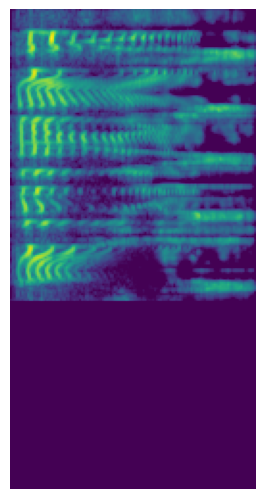

<Figure size 1000x600 with 0 Axes>

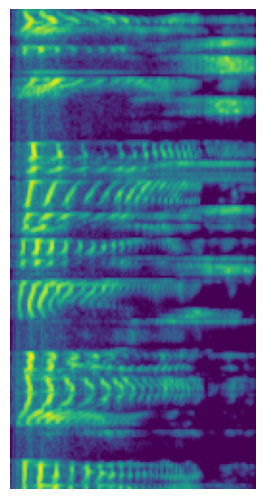

<Figure size 1000x600 with 0 Axes>

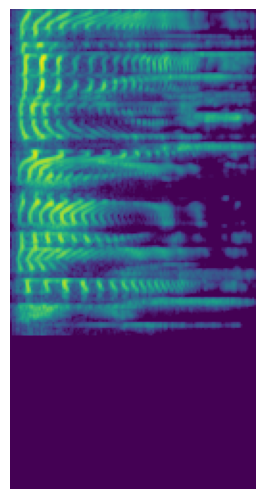

<Figure size 1000x600 with 0 Axes>

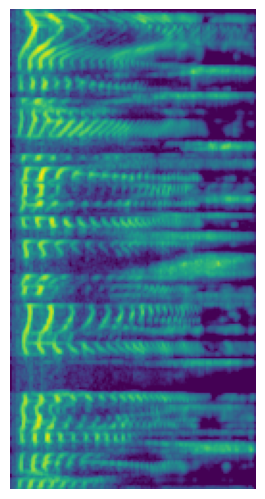

<Figure size 1000x600 with 0 Axes>

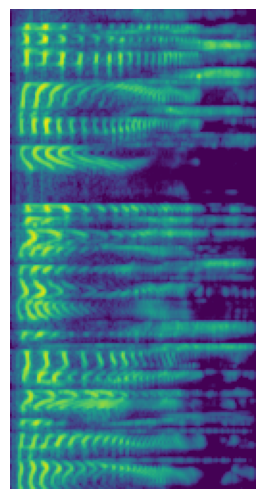

<Figure size 1000x600 with 0 Axes>

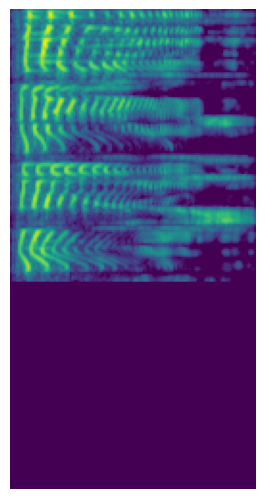

<Figure size 1000x600 with 0 Axes>

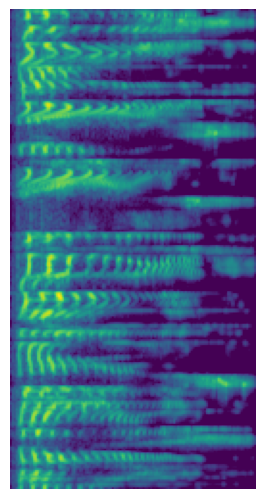

<Figure size 1000x600 with 0 Axes>

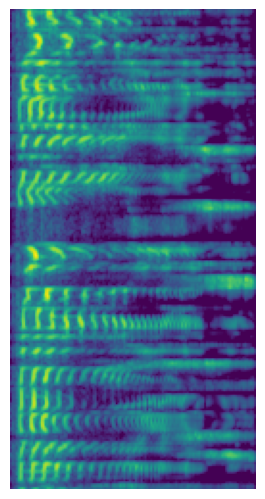

<Figure size 1000x600 with 0 Axes>

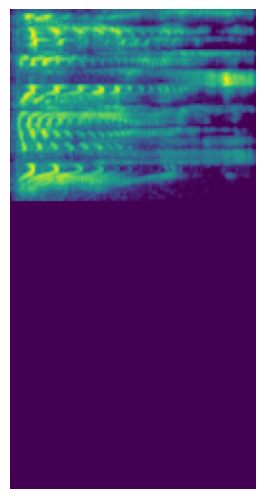

<Figure size 1000x600 with 0 Axes>

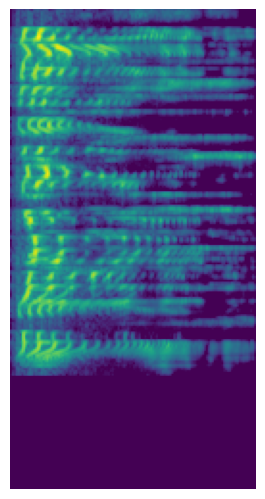

<Figure size 1000x600 with 0 Axes>

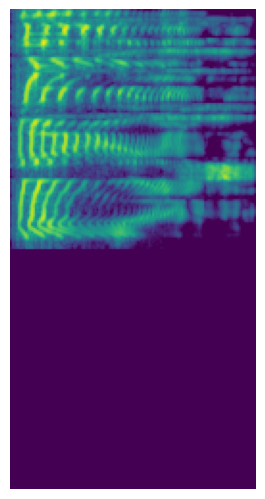

<Figure size 1000x600 with 0 Axes>

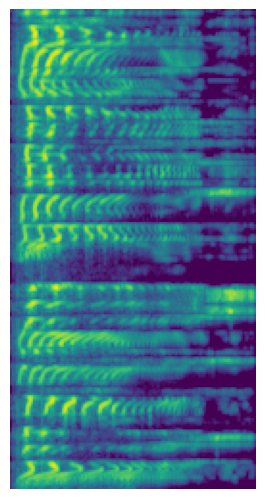

<Figure size 1000x600 with 0 Axes>

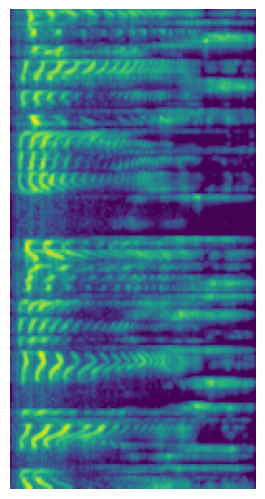

<Figure size 1000x600 with 0 Axes>

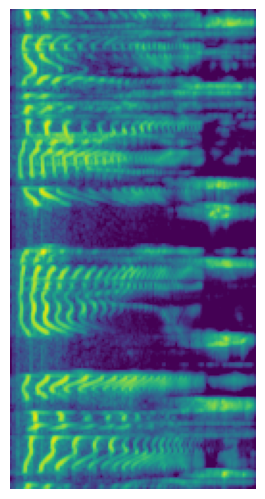

<Figure size 1000x600 with 0 Axes>

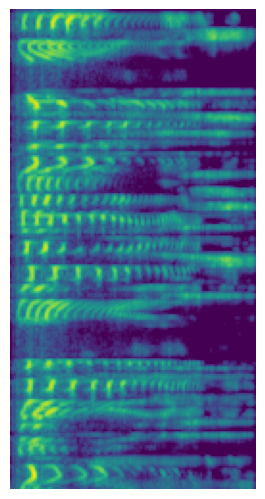

<Figure size 1000x600 with 0 Axes>

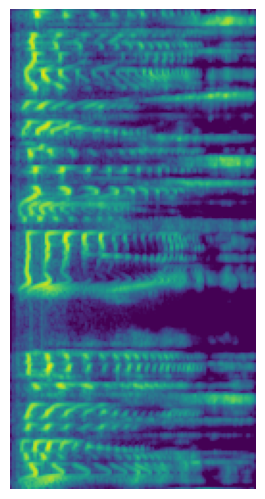

<Figure size 1000x600 with 0 Axes>

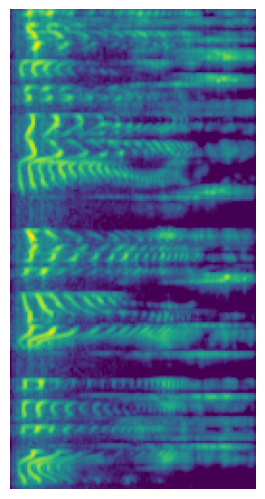

<Figure size 1000x600 with 0 Axes>

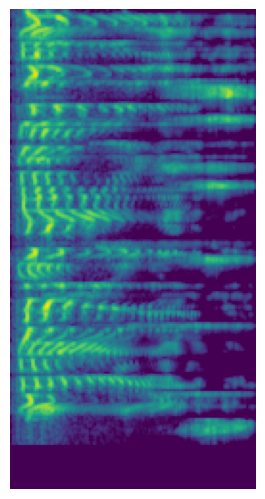

<Figure size 1000x600 with 0 Axes>

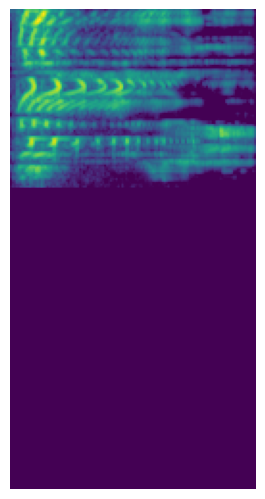

<Figure size 1000x600 with 0 Axes>

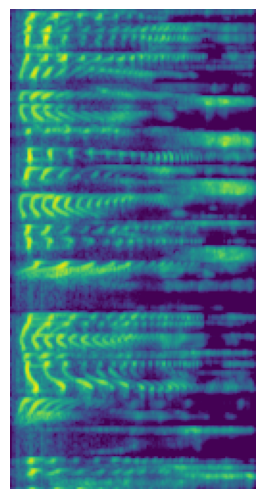

<Figure size 1000x600 with 0 Axes>

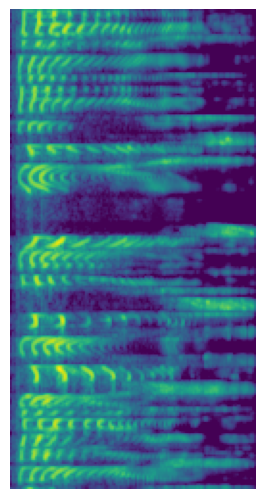

<Figure size 1000x600 with 0 Axes>

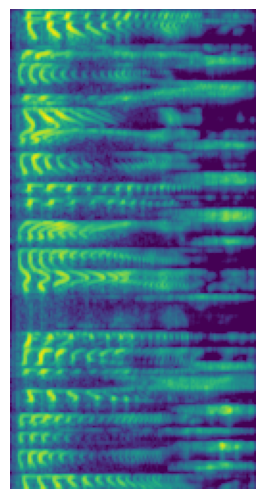

<Figure size 1000x600 with 0 Axes>

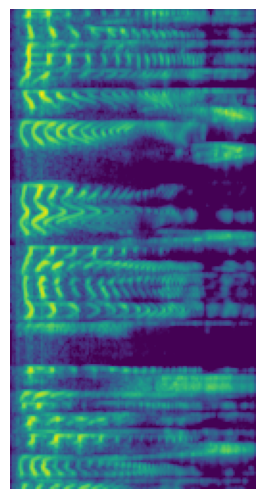

<Figure size 1000x600 with 0 Axes>

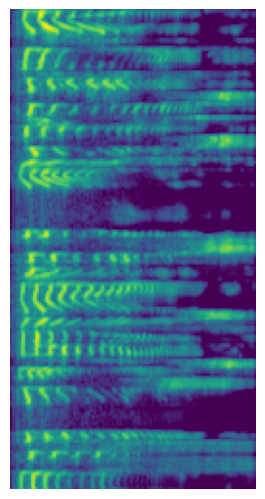

<Figure size 1000x600 with 0 Axes>

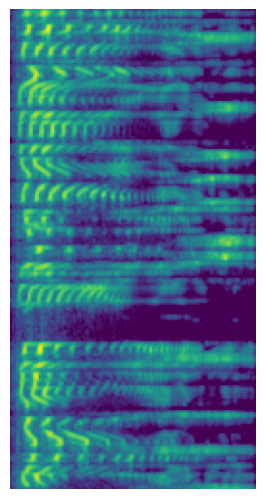

<Figure size 1000x600 with 0 Axes>

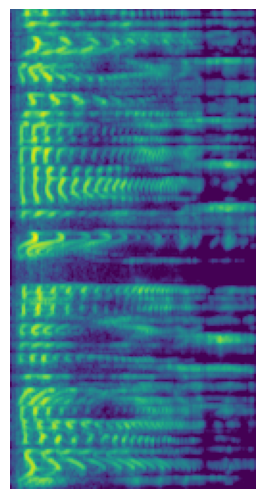

<Figure size 1000x600 with 0 Axes>

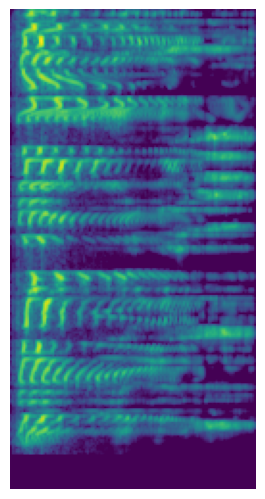

<Figure size 1000x600 with 0 Axes>

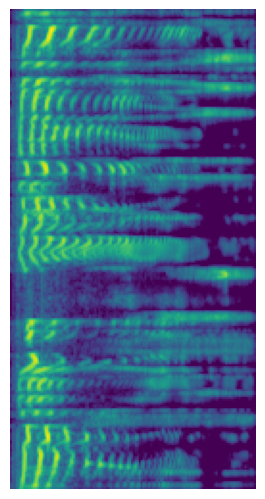

<Figure size 1000x600 with 0 Axes>

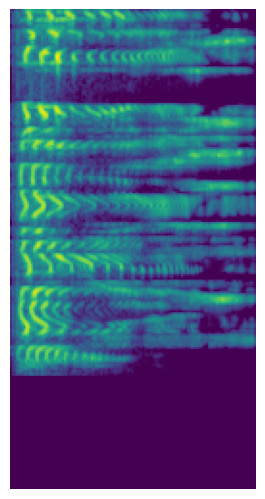

<Figure size 1000x600 with 0 Axes>

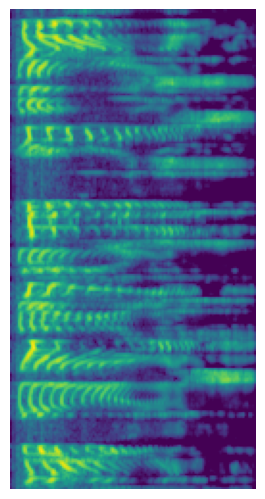

<Figure size 1000x600 with 0 Axes>

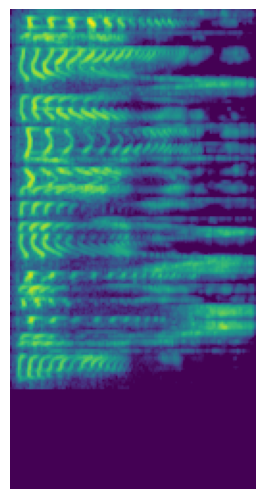

<Figure size 1000x600 with 0 Axes>

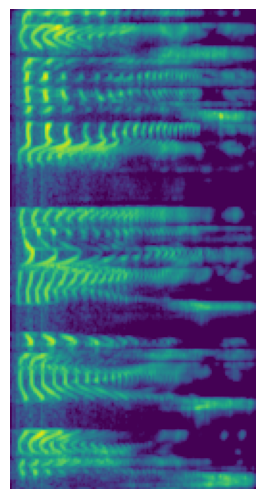

<Figure size 1000x600 with 0 Axes>

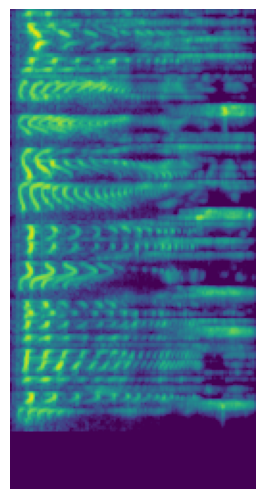

<Figure size 1000x600 with 0 Axes>

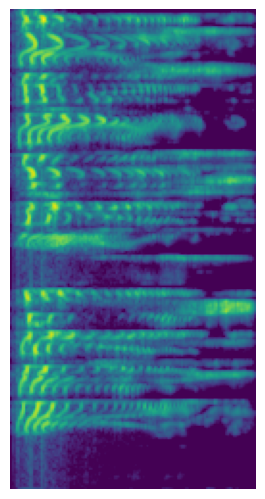

<Figure size 1000x600 with 0 Axes>

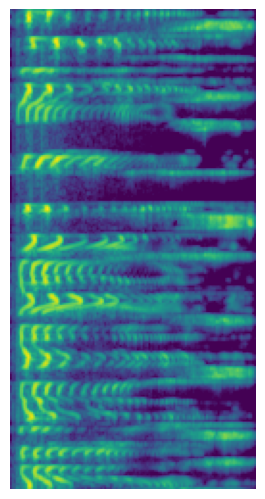

<Figure size 1000x600 with 0 Axes>

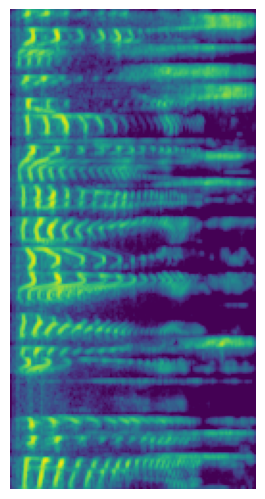

<Figure size 1000x600 with 0 Axes>

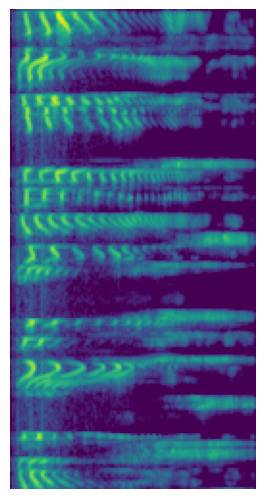

<Figure size 1000x600 with 0 Axes>

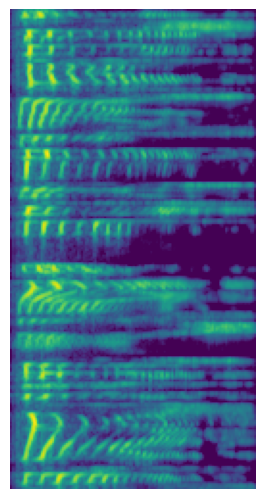

<Figure size 1000x600 with 0 Axes>

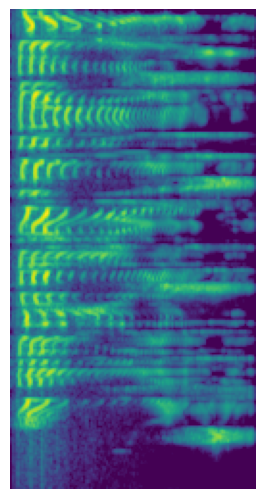

<Figure size 1000x600 with 0 Axes>

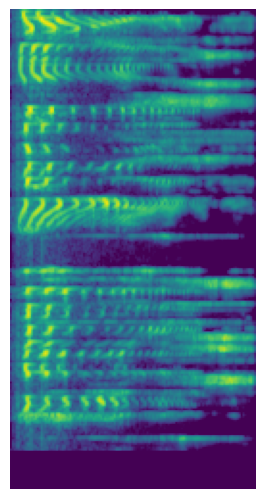

<Figure size 1000x600 with 0 Axes>

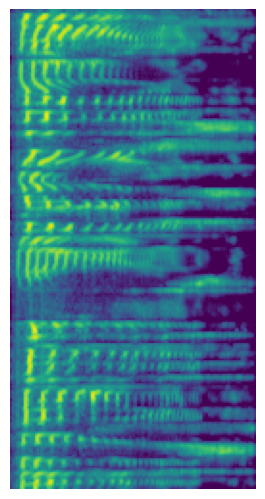

<Figure size 1000x600 with 0 Axes>

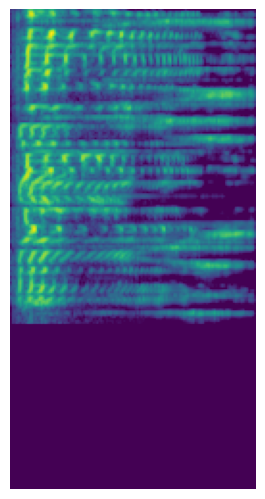

<Figure size 1000x600 with 0 Axes>

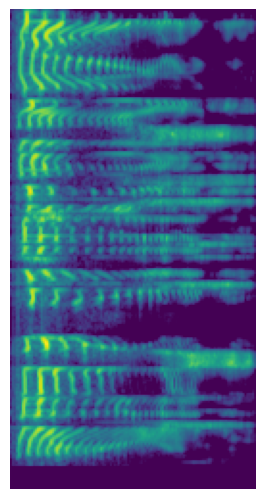

<Figure size 1000x600 with 0 Axes>

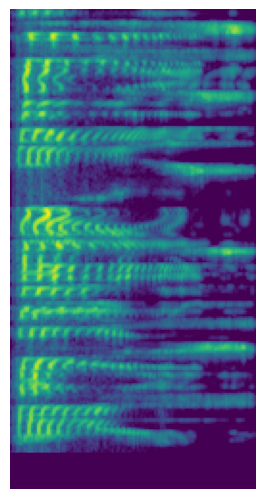

<Figure size 1000x600 with 0 Axes>

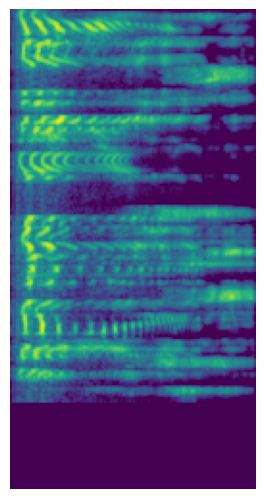

<Figure size 1000x600 with 0 Axes>

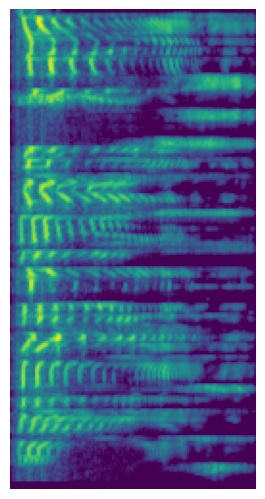

<Figure size 1000x600 with 0 Axes>

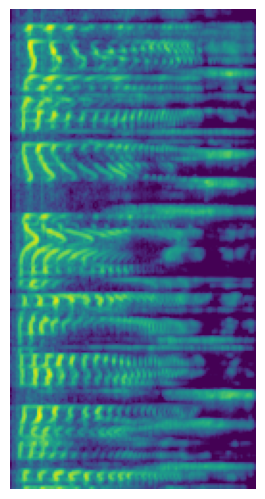

<Figure size 1000x600 with 0 Axes>

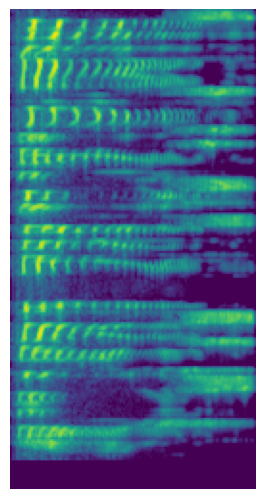

<Figure size 1000x600 with 0 Axes>

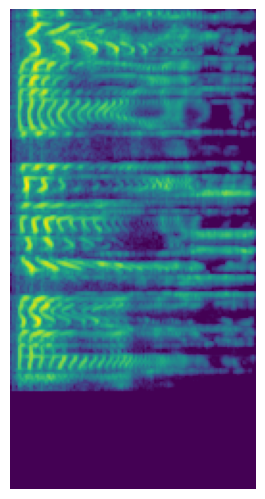

<Figure size 1000x600 with 0 Axes>

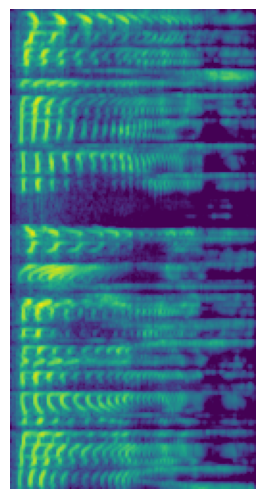

<Figure size 1000x600 with 0 Axes>

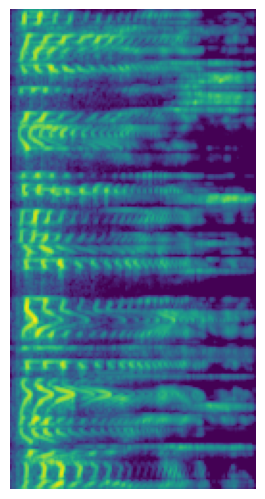

<Figure size 1000x600 with 0 Axes>

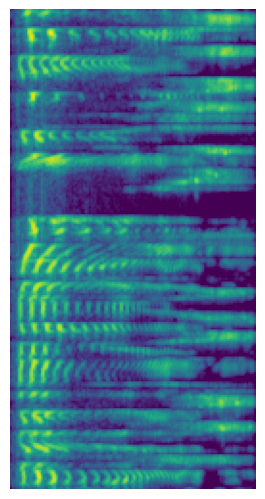

<Figure size 1000x600 with 0 Axes>

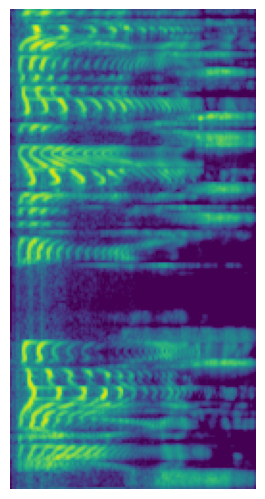

<Figure size 1000x600 with 0 Axes>

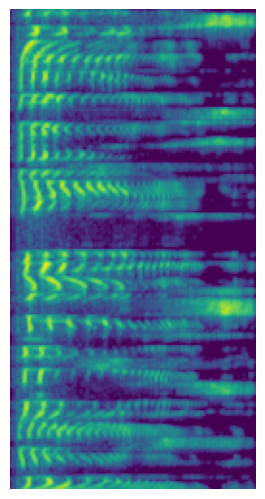

<Figure size 1000x600 with 0 Axes>

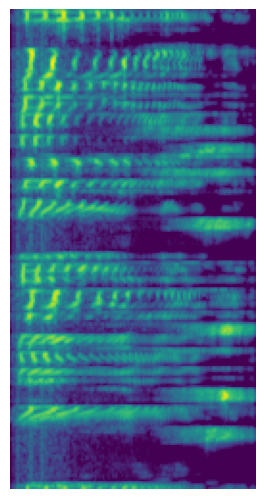

<Figure size 1000x600 with 0 Axes>

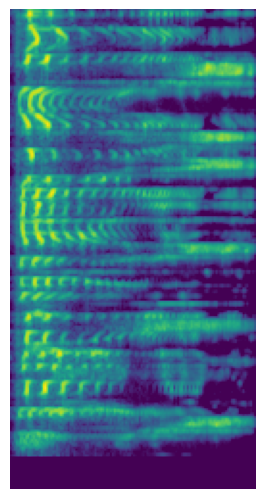

<Figure size 1000x600 with 0 Axes>

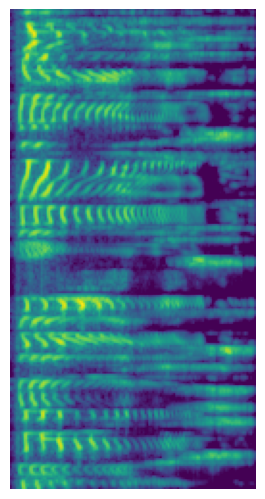

<Figure size 1000x600 with 0 Axes>

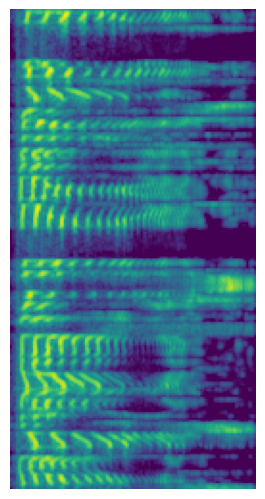

<Figure size 1000x600 with 0 Axes>

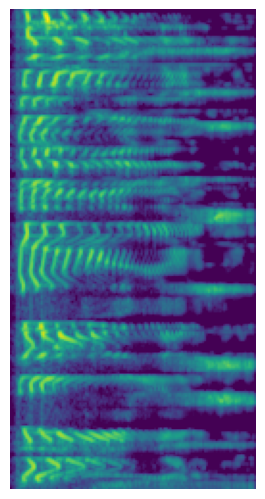

<Figure size 1000x600 with 0 Axes>

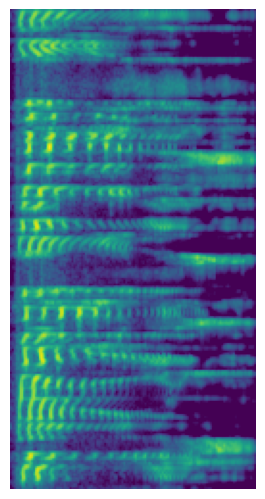

<Figure size 1000x600 with 0 Axes>

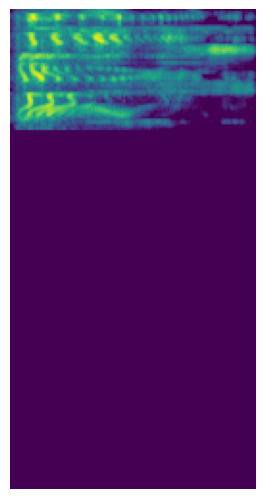

<Figure size 1000x600 with 0 Axes>

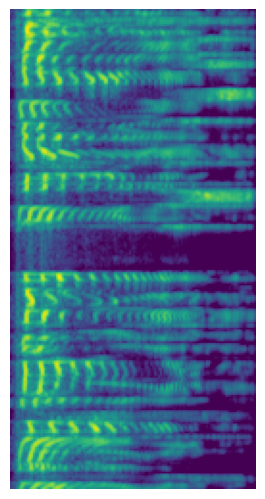

<Figure size 1000x600 with 0 Axes>

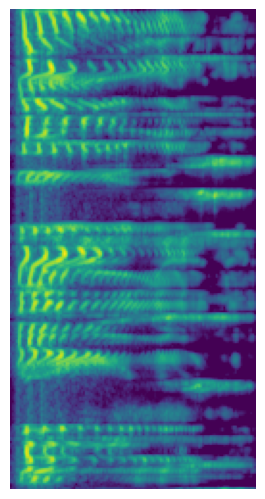

<Figure size 1000x600 with 0 Axes>

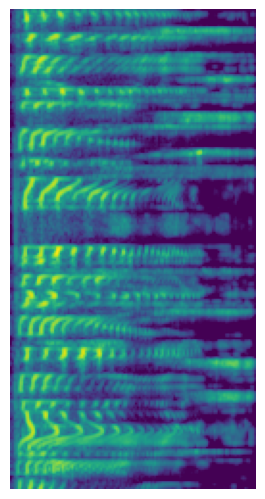

<Figure size 1000x600 with 0 Axes>

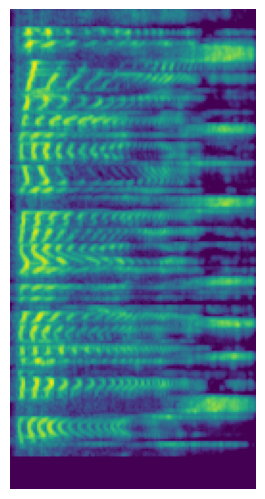

<Figure size 1000x600 with 0 Axes>

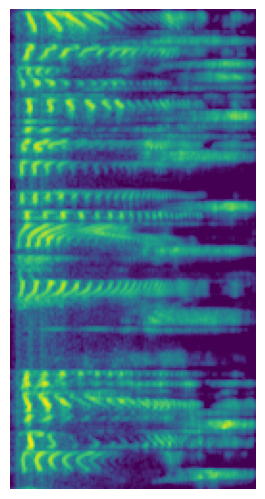

<Figure size 1000x600 with 0 Axes>

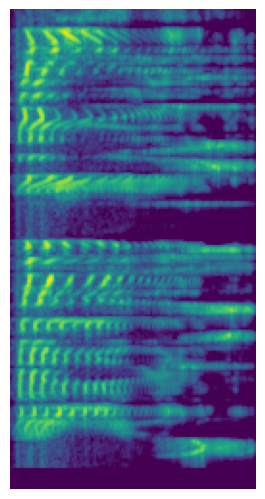

<Figure size 1000x600 with 0 Axes>

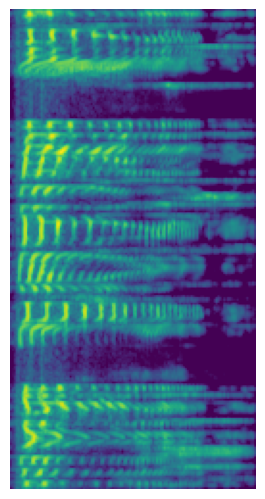

<Figure size 1000x600 with 0 Axes>

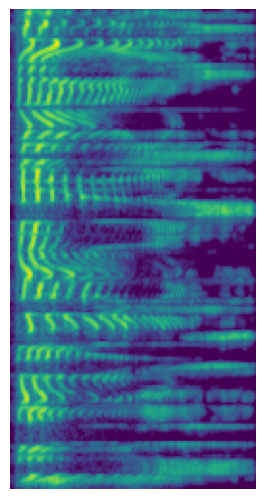

<Figure size 1000x600 with 0 Axes>

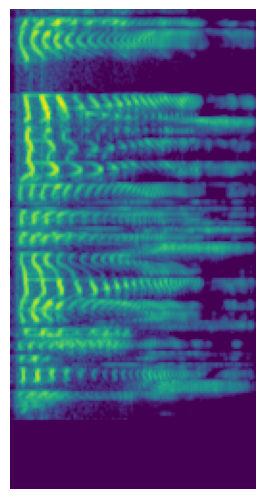

<Figure size 1000x600 with 0 Axes>

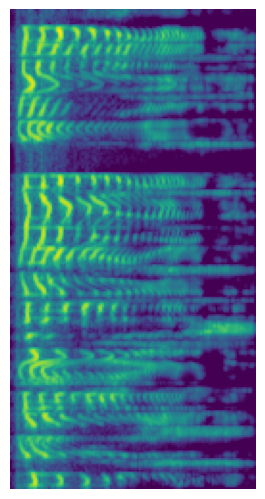

<Figure size 1000x600 with 0 Axes>

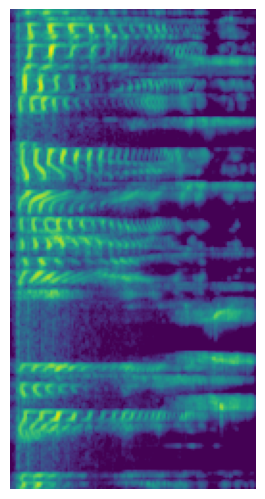

<Figure size 1000x600 with 0 Axes>

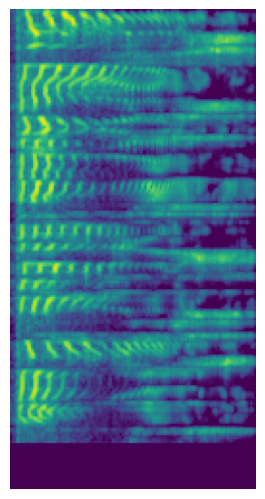

<Figure size 1000x600 with 0 Axes>

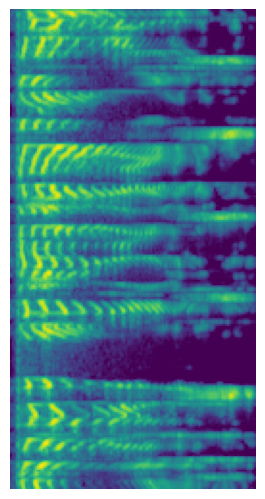

<Figure size 1000x600 with 0 Axes>

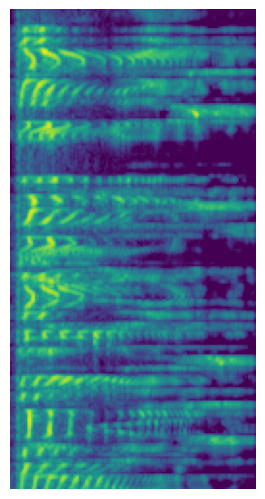

<Figure size 1000x600 with 0 Axes>

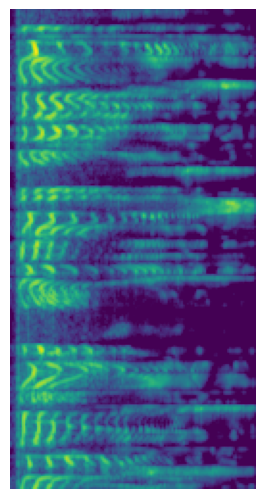

<Figure size 1000x600 with 0 Axes>

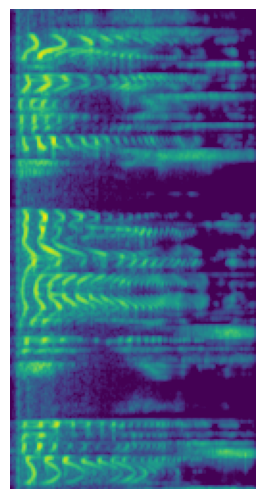

<Figure size 1000x600 with 0 Axes>

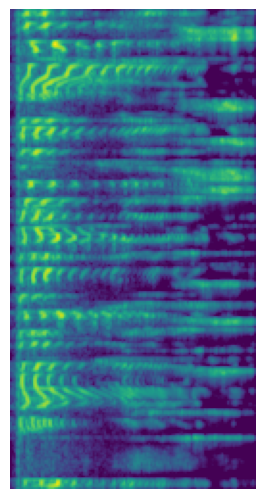

<Figure size 1000x600 with 0 Axes>

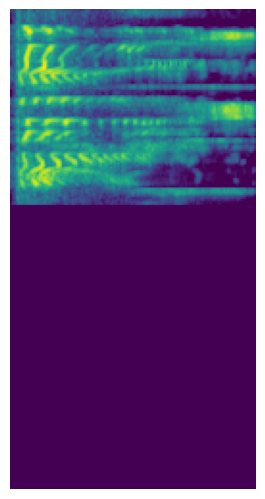

<Figure size 1000x600 with 0 Axes>

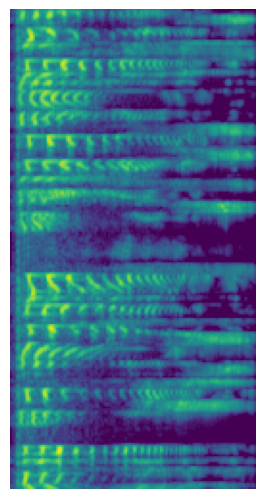

<Figure size 1000x600 with 0 Axes>

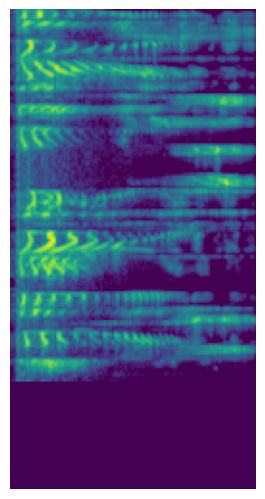

<Figure size 1000x600 with 0 Axes>

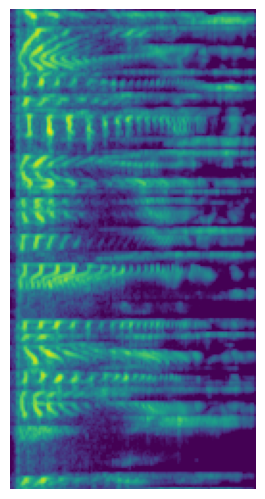

In [ ]:
import matplotlib.pyplot as plt

# Visualizar la imagen generada
for i in range(82):
  plt.figure(figsize=(10, 6))
  fig, ax = plt.subplots()
  ax.imshow(y_val[i])  # Ajusta cmap y otros parámetros según tus necesidades
  ax.axis('off')
  plt.subplots_adjust(left=0,right=1,top=1,bottom=0)
  plt.show()

<Figure size 1000x600 with 0 Axes>

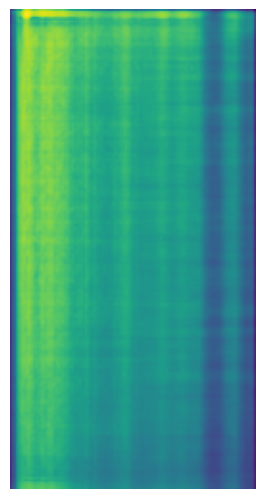

<Figure size 1000x600 with 0 Axes>

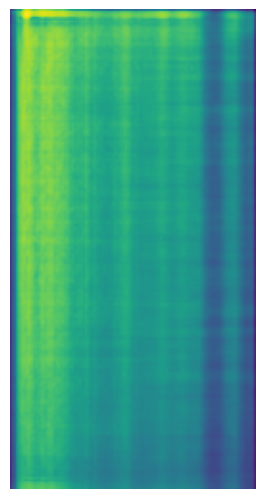

<Figure size 1000x600 with 0 Axes>

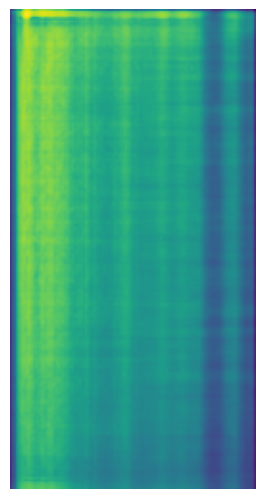

<Figure size 1000x600 with 0 Axes>

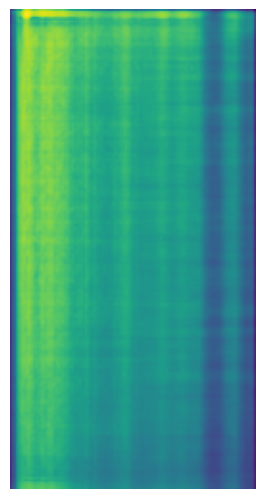

<Figure size 1000x600 with 0 Axes>

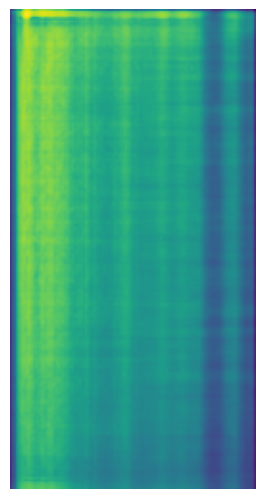

<Figure size 1000x600 with 0 Axes>

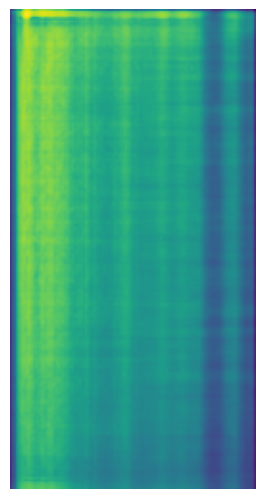

<Figure size 1000x600 with 0 Axes>

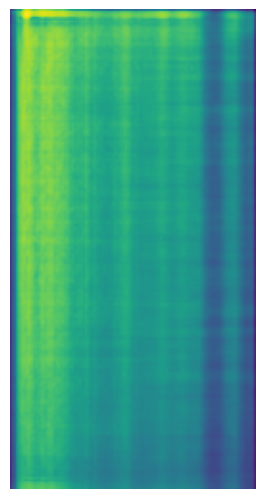

<Figure size 1000x600 with 0 Axes>

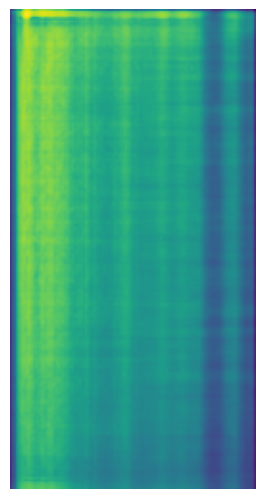

<Figure size 1000x600 with 0 Axes>

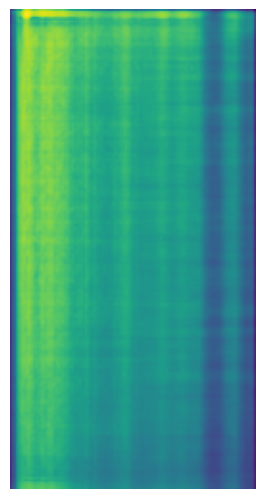

<Figure size 1000x600 with 0 Axes>

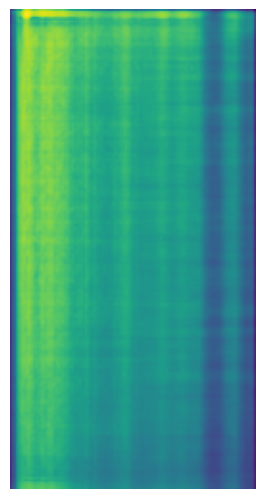

<Figure size 1000x600 with 0 Axes>

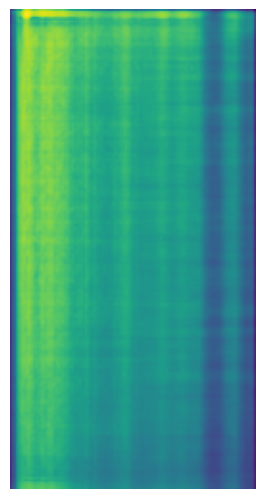

<Figure size 1000x600 with 0 Axes>

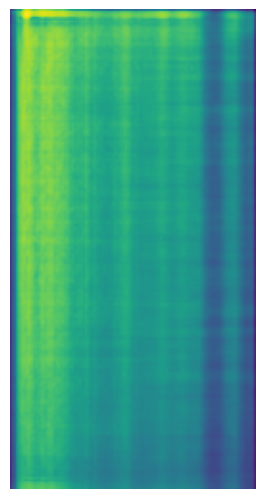

<Figure size 1000x600 with 0 Axes>

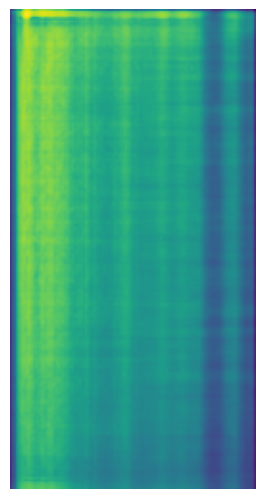

<Figure size 1000x600 with 0 Axes>

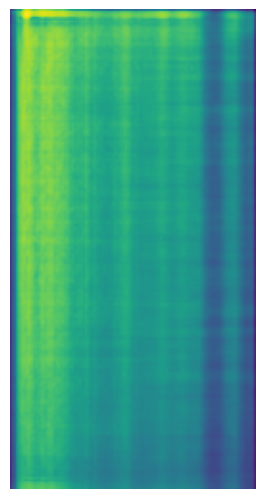

<Figure size 1000x600 with 0 Axes>

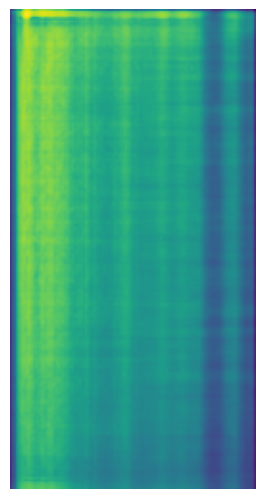

<Figure size 1000x600 with 0 Axes>

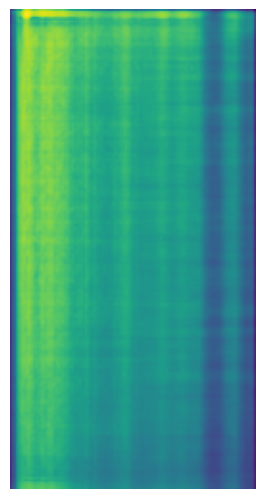

<Figure size 1000x600 with 0 Axes>

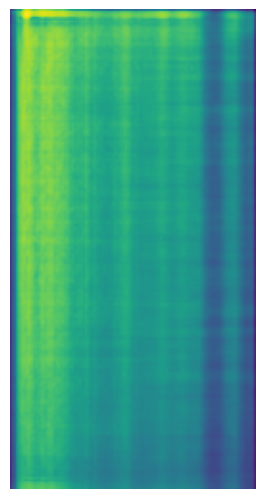

<Figure size 1000x600 with 0 Axes>

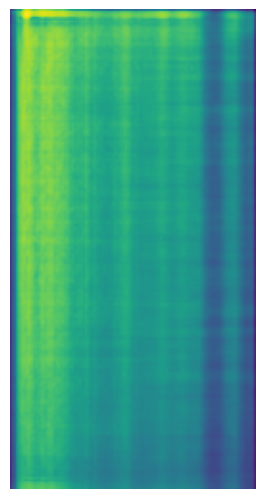

<Figure size 1000x600 with 0 Axes>

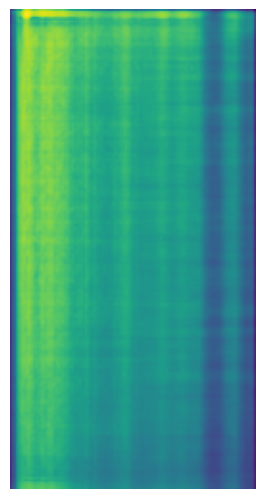

<Figure size 1000x600 with 0 Axes>

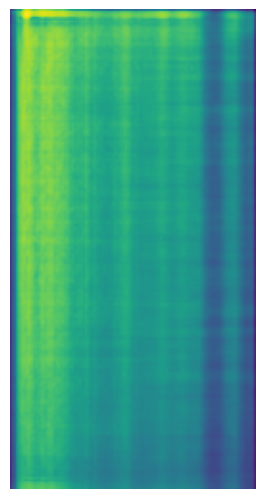

<Figure size 1000x600 with 0 Axes>

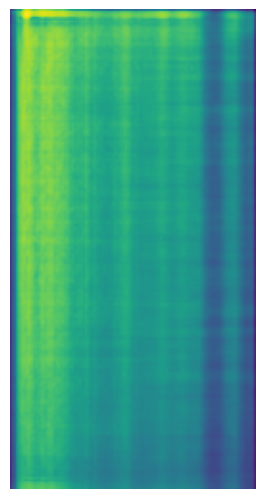

<Figure size 1000x600 with 0 Axes>

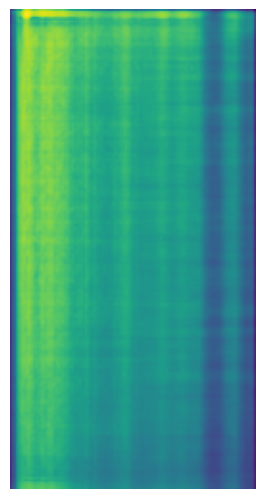

<Figure size 1000x600 with 0 Axes>

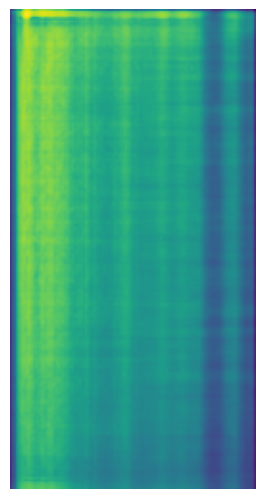

<Figure size 1000x600 with 0 Axes>

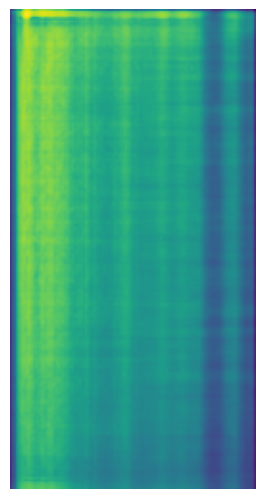

<Figure size 1000x600 with 0 Axes>

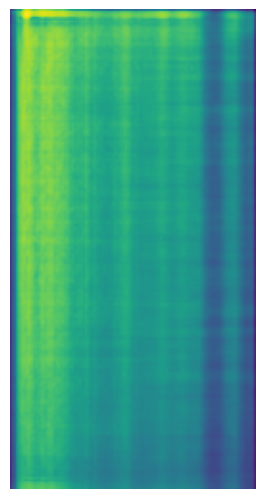

<Figure size 1000x600 with 0 Axes>

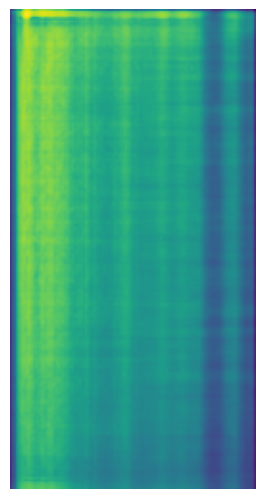

<Figure size 1000x600 with 0 Axes>

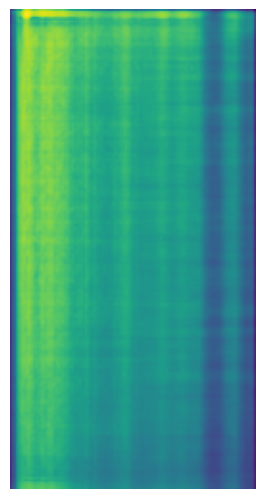

<Figure size 1000x600 with 0 Axes>

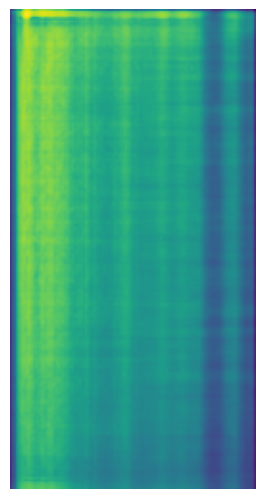

<Figure size 1000x600 with 0 Axes>

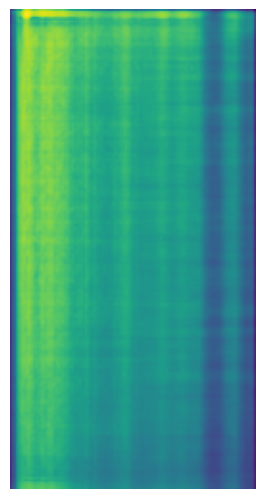

<Figure size 1000x600 with 0 Axes>

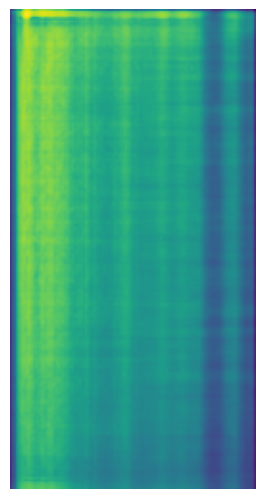

<Figure size 1000x600 with 0 Axes>

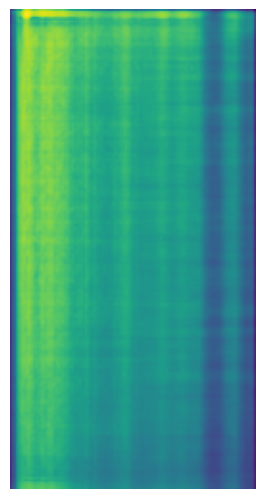

<Figure size 1000x600 with 0 Axes>

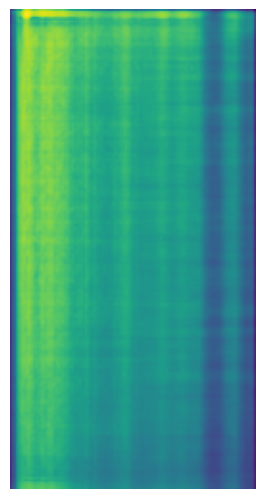

<Figure size 1000x600 with 0 Axes>

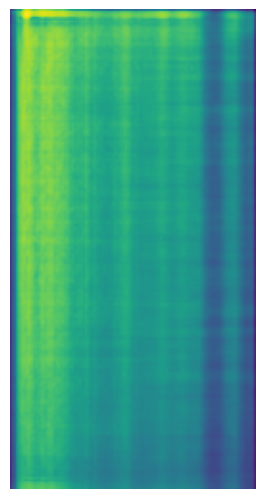

<Figure size 1000x600 with 0 Axes>

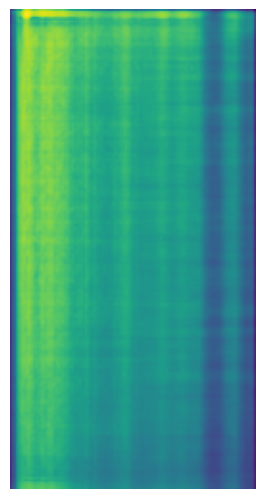

<Figure size 1000x600 with 0 Axes>

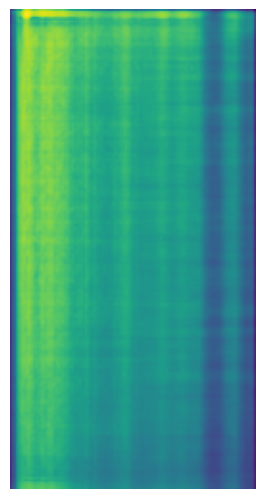

<Figure size 1000x600 with 0 Axes>

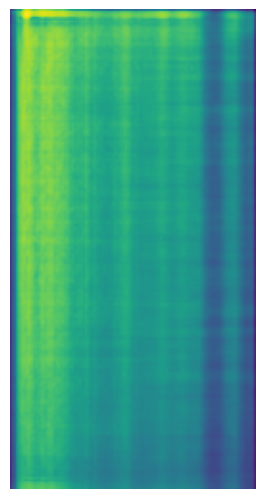

<Figure size 1000x600 with 0 Axes>

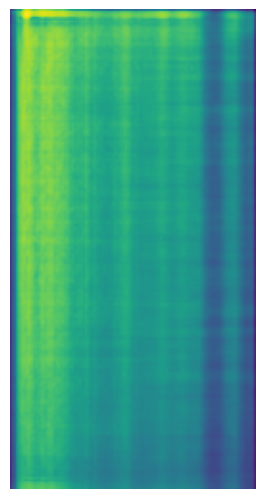

<Figure size 1000x600 with 0 Axes>

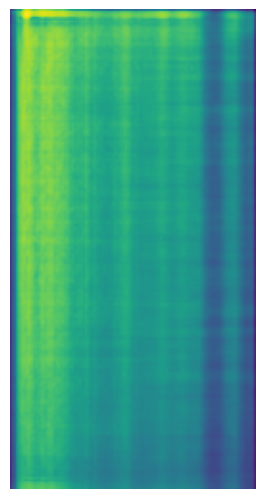

<Figure size 1000x600 with 0 Axes>

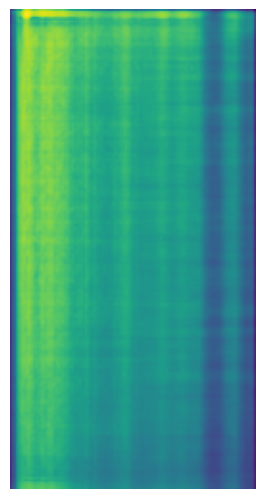

<Figure size 1000x600 with 0 Axes>

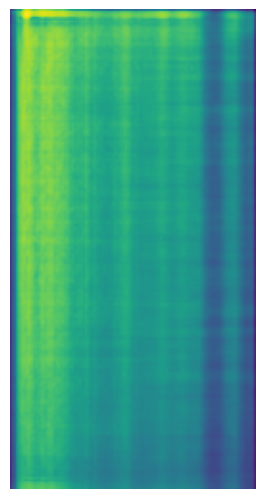

<Figure size 1000x600 with 0 Axes>

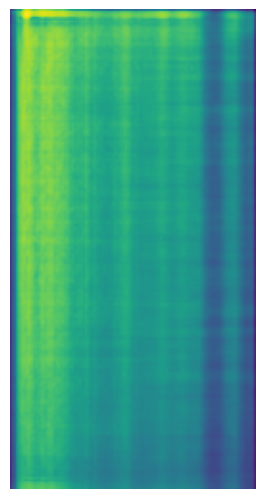

<Figure size 1000x600 with 0 Axes>

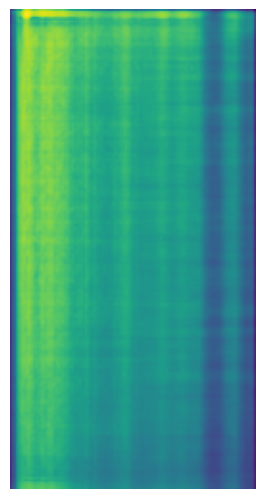

<Figure size 1000x600 with 0 Axes>

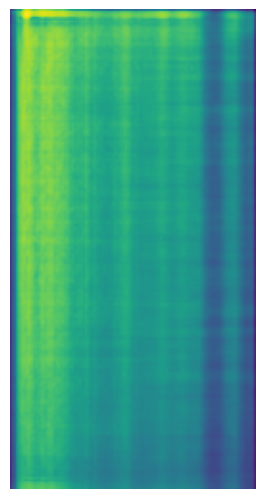

<Figure size 1000x600 with 0 Axes>

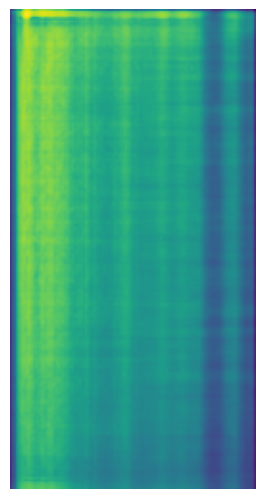

<Figure size 1000x600 with 0 Axes>

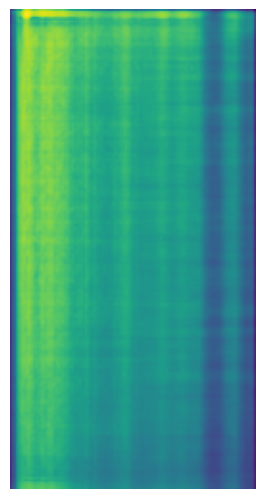

<Figure size 1000x600 with 0 Axes>

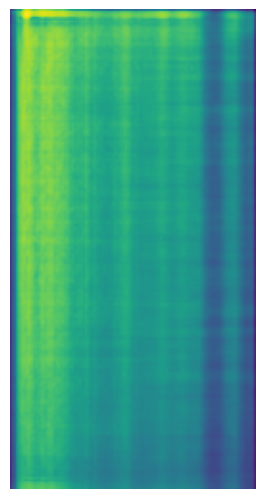

<Figure size 1000x600 with 0 Axes>

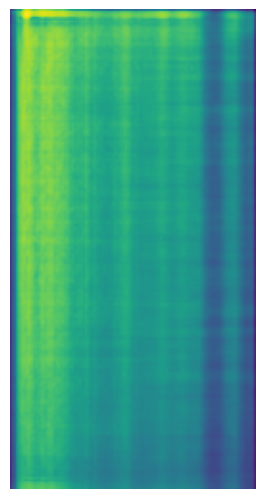

<Figure size 1000x600 with 0 Axes>

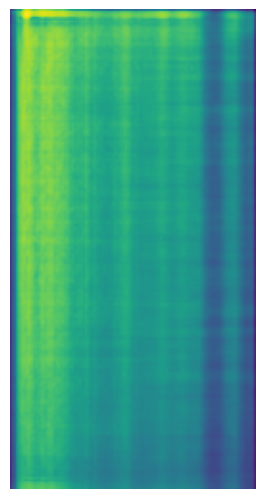

<Figure size 1000x600 with 0 Axes>

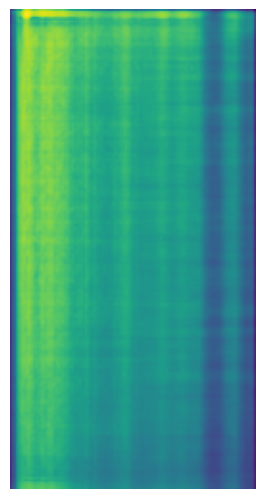

<Figure size 1000x600 with 0 Axes>

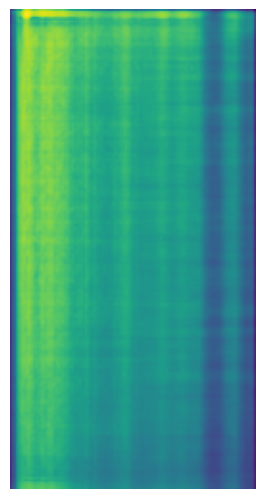

<Figure size 1000x600 with 0 Axes>

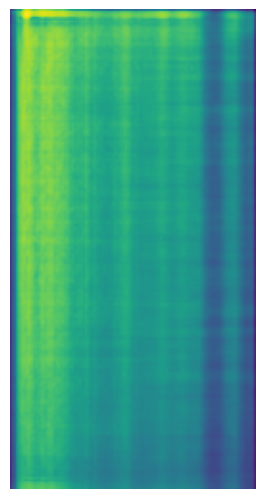

<Figure size 1000x600 with 0 Axes>

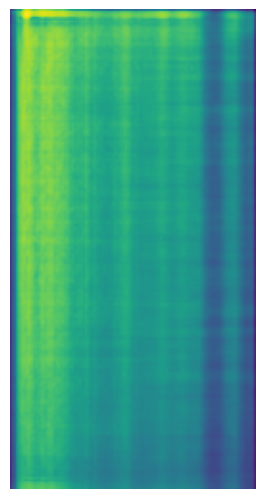

<Figure size 1000x600 with 0 Axes>

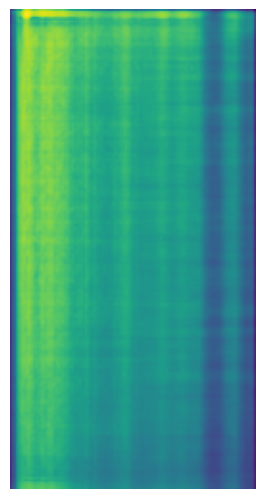

<Figure size 1000x600 with 0 Axes>

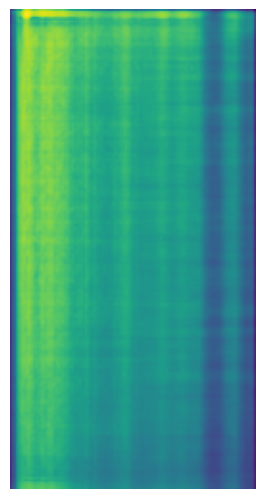

<Figure size 1000x600 with 0 Axes>

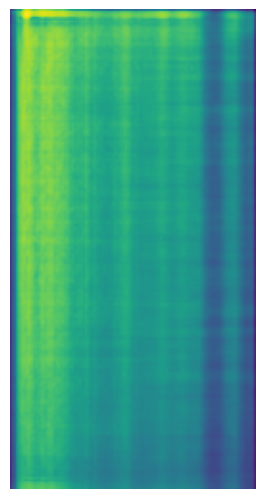

<Figure size 1000x600 with 0 Axes>

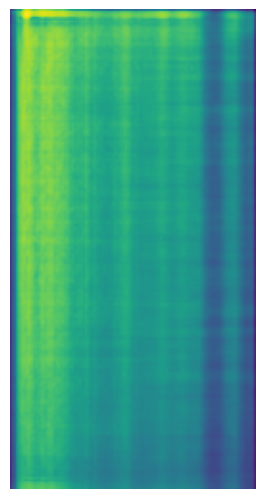

<Figure size 1000x600 with 0 Axes>

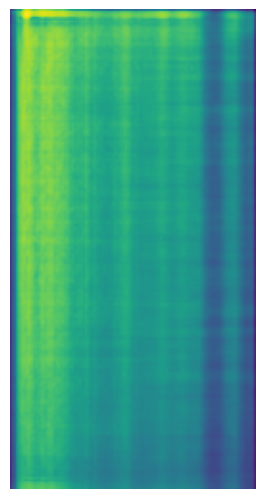

<Figure size 1000x600 with 0 Axes>

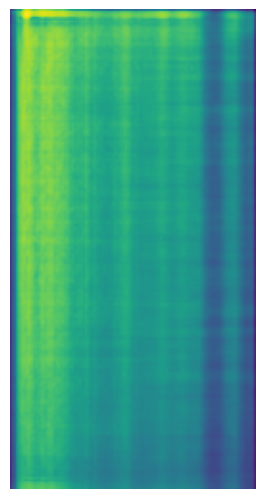

<Figure size 1000x600 with 0 Axes>

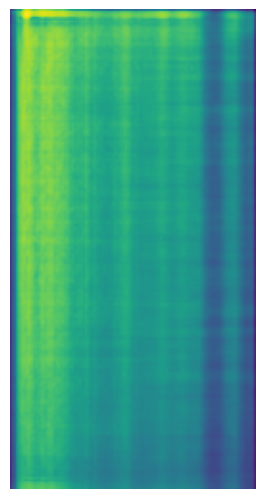

<Figure size 1000x600 with 0 Axes>

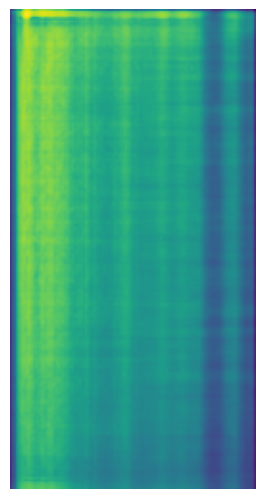

<Figure size 1000x600 with 0 Axes>

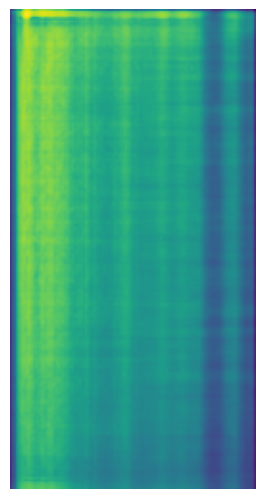

<Figure size 1000x600 with 0 Axes>

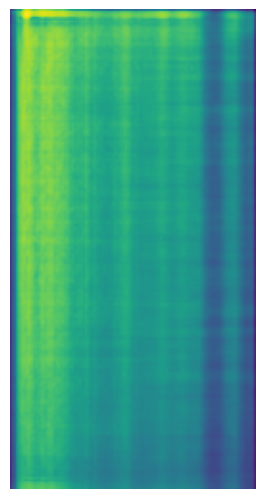

<Figure size 1000x600 with 0 Axes>

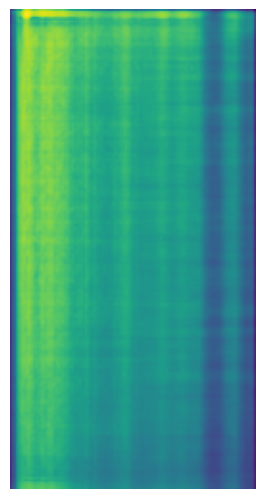

<Figure size 1000x600 with 0 Axes>

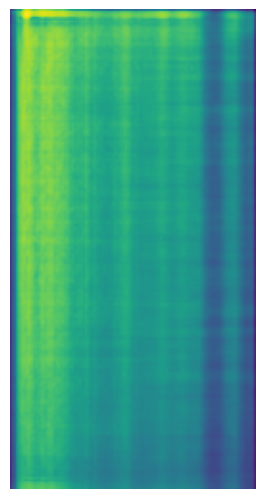

<Figure size 1000x600 with 0 Axes>

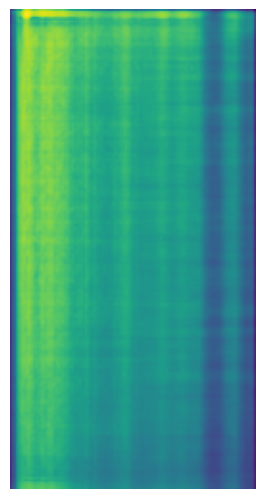

<Figure size 1000x600 with 0 Axes>

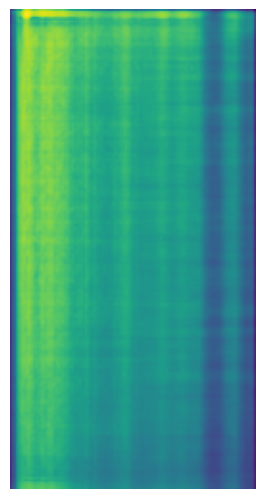

<Figure size 1000x600 with 0 Axes>

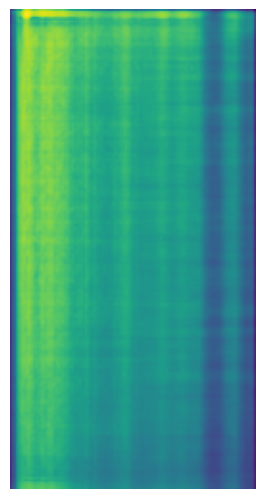

<Figure size 1000x600 with 0 Axes>

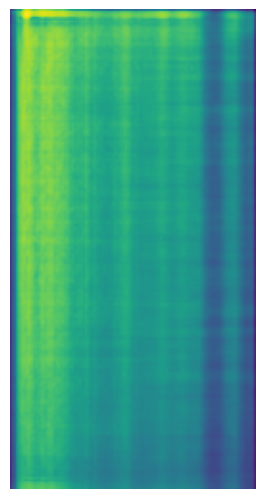

<Figure size 1000x600 with 0 Axes>

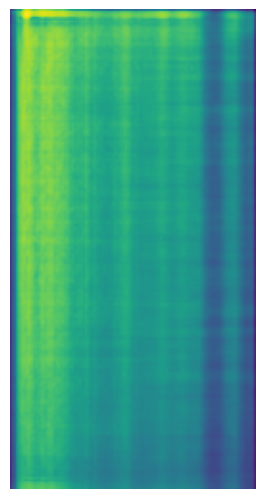

<Figure size 1000x600 with 0 Axes>

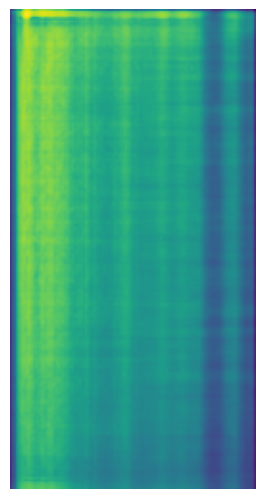

<Figure size 1000x600 with 0 Axes>

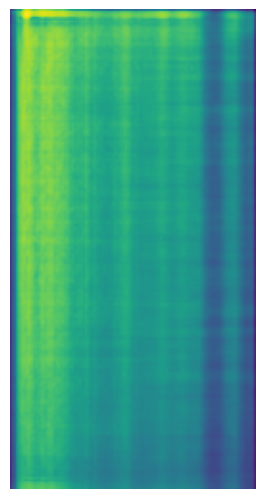

<Figure size 1000x600 with 0 Axes>

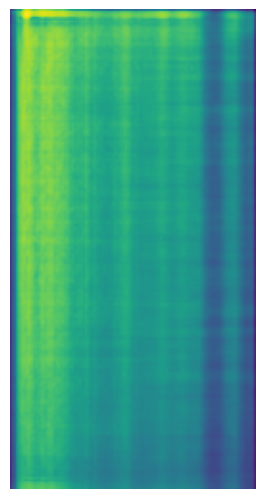

<Figure size 1000x600 with 0 Axes>

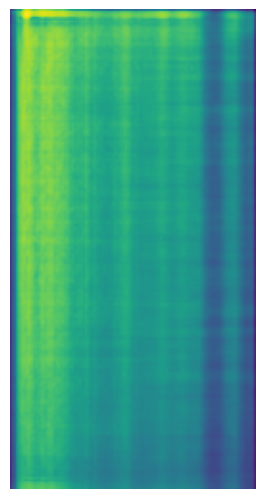

<Figure size 1000x600 with 0 Axes>

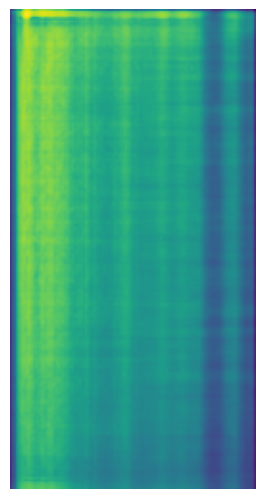

<Figure size 1000x600 with 0 Axes>

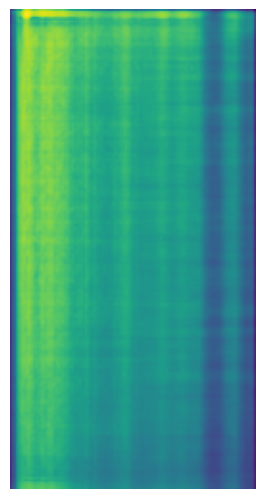

<Figure size 1000x600 with 0 Axes>

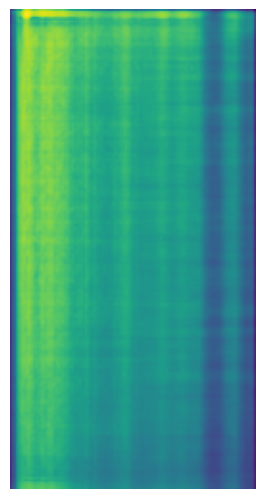

<Figure size 1000x600 with 0 Axes>

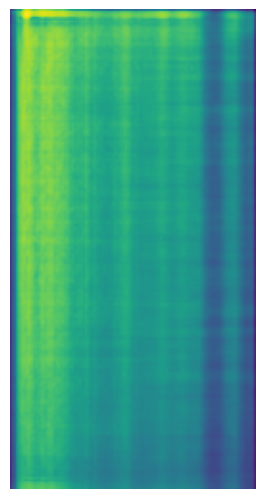

<Figure size 1000x600 with 0 Axes>

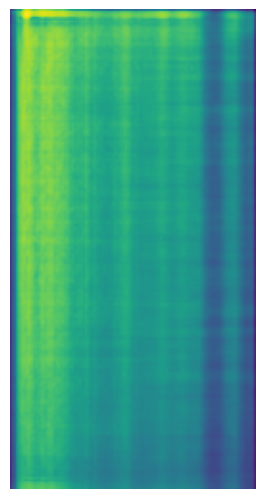

<Figure size 1000x600 with 0 Axes>

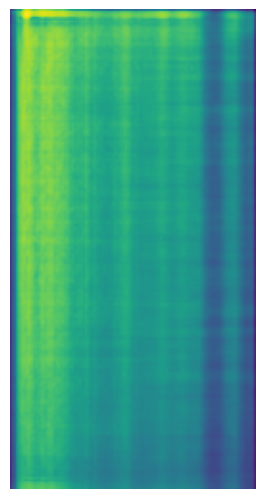

<Figure size 1000x600 with 0 Axes>

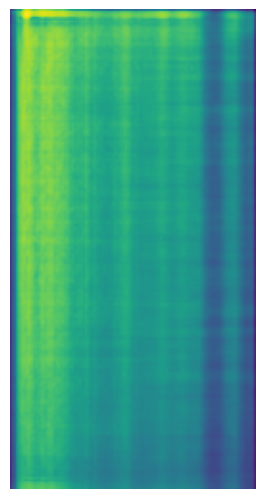

<Figure size 1000x600 with 0 Axes>

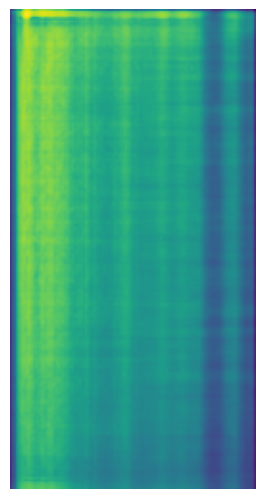

<Figure size 1000x600 with 0 Axes>

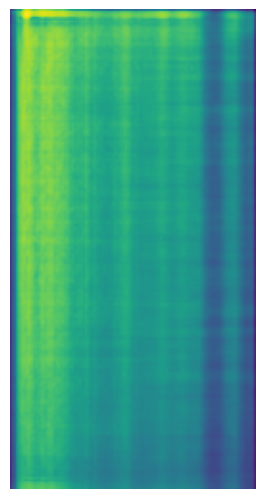

In [ ]:
import matplotlib.pyplot as plt

# Visualizar la imagen generada
for i in range(82):
  plt.figure(figsize=(10, 6))
  fig, ax = plt.subplots()
  ax.imshow(generated_image[i])  # Ajusta cmap y otros parámetros según tus necesidades
  ax.axis('off')
  plt.subplots_adjust(left=0,right=1,top=1,bottom=0)
  plt.show()


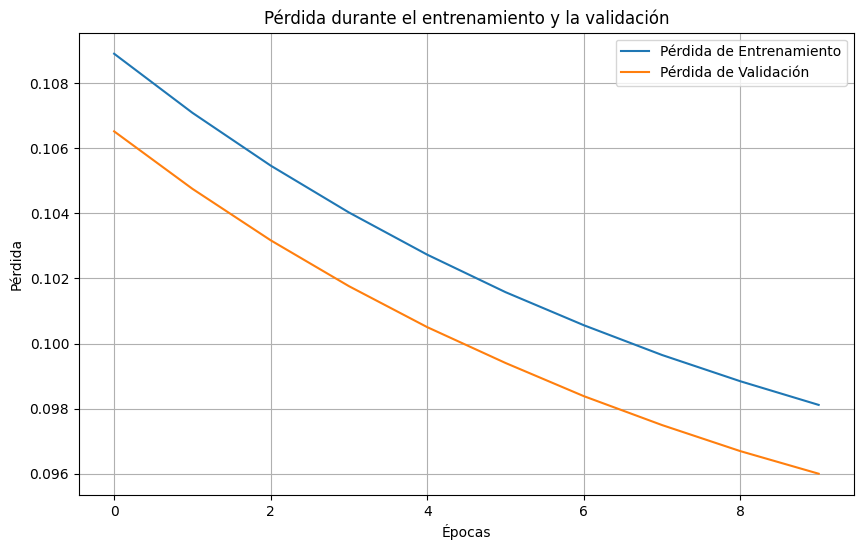

In [ ]:
# Graficar la pérdida
plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Pérdida de Entrenamiento')
plt.plot(history.history['val_loss'], label='Pérdida de Validación')
plt.title('Pérdida durante el entrenamiento y la validación')
plt.xlabel('Épocas')
plt.ylabel('Pérdida')
plt.legend()
plt.grid()
plt.show()
